# EQUIX: Jq divergence

In [ ]:
%load_ext watermark
%matplotlib inline


import glob
import os

import cf_xarray as cfxr
import dcpy
import distributed
import hvplot.xarray
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
from dcpy.oceans import read_osu_microstructure_mat
from IPython.display import Image

# import eddydiff as ed
import pump

xr.set_options(keep_attrs=True)
mpl.rcParams["figure.dpi"] = 140

%watermark -iv

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
xarray     : 0.19.0
cf_xarray  : 0.5.3.dev29+g3660810.d20210729
numpy      : 1.21.3
hvplot     : 0.7.3
dcpy       : 0.1
matplotlib : 3.4.3
distributed: 2021.10.0
pump       : 0.1



## Read data

In [ ]:
# th = xr.load_dataset("/home/deepak/datasets/microstructure/osu/tropicheat.nc")
# tiwe = xr.load_dataset("/home/deepak/datasets/microstructure/osu/tiwe.nc")
equix = xr.load_dataset("/home/deepak/datasets/microstructure/osu/equix.nc")

tao = xr.open_dataset(
    "/home/deepak/work/datasets/microstructure/osu/equix/hourly_tao.nc"
)
iop = xr.open_dataset(
    "/home/deepak/work/datasets/microstructure/osu/equix/hourly_iop.nc"
)
eop = xr.open_dataset(
    "/home/deepak/work/datasets/microstructure/osu/equix/hourly_eop.nc"
)

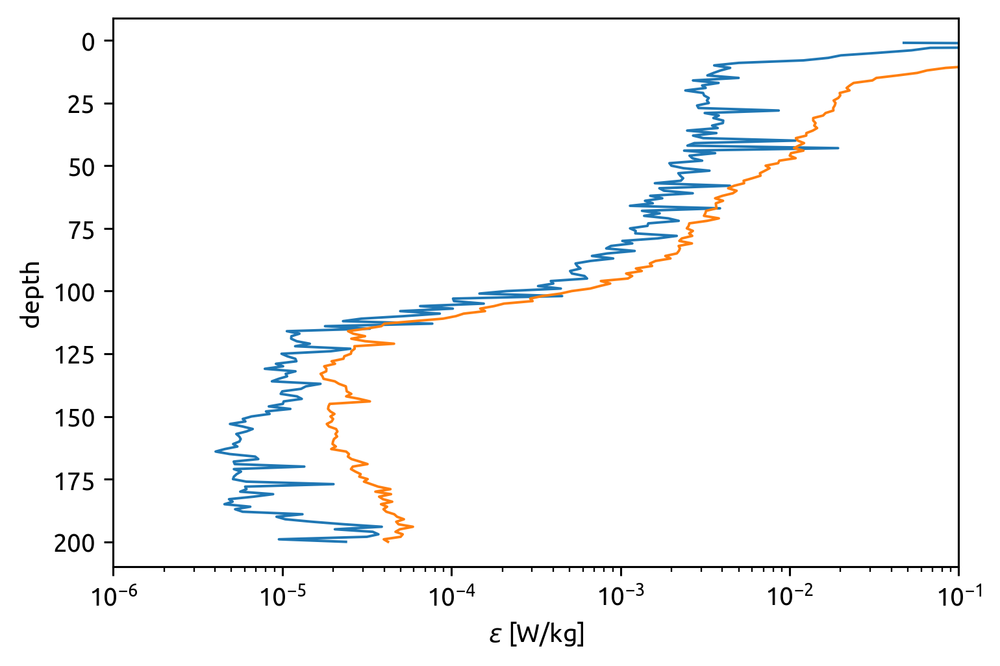

In [ ]:
%matplotlib inline
plt.rcParams["figure.dpi"] = 140

np.abs(equix.chi / 2 / (equix.dTdz.where(np.abs(equix.dTdz) > 5e-3) ** 2)).mean(
    "time"
).plot(y="depth", yincrease=False)
np.abs(0.2 * equix.eps / equix.N2).mean("time").plot(
    y="depth", yincrease=False, xscale="log", xlim=(1e-6, 1e-1)
)

## Chameleon dJ/dz estimate

In [ ]:
subset = equix.sel(time=slice("2008-10-29", "2008-11-03"))

In [ ]:
eps_plot = subset.eps.hvplot.quadmesh(
    y="depth",
    x="time",
    cmap="RdYlBu_r",
    cnorm="log",
    clim=(1e-10, 1e-5),
    ylim=(200, 0),
)

theta_contours = subset.theta.hvplot.contour(
    # levels=[21, 22, 23, 24], #colors="gray", #linewidths=0.5, x="time", ax=ax[0]
)
# equix.theta.cf.plot.contour(
#    levels=bins, colors="k", linewidths=0.25, x="time", ax=ax[0]
# )
# equix.mld.plot(color="g", ax=ax[0], lw=0.25)
# equix.eucmax.plot(color="k", ax=ax[0], lw=0.5)
# dcpy.plots.liney(iop.depth.data, zorder=10, color="w", ax=ax[0])
# dcpy.plots.liney(tao.depth.data, zorder=10, color="cyan", ax=ax[0])

eps_plot * theta_contours

:Overlay
   .QuadMesh.I :QuadMesh   [time,depth]   (eps)
   .Contours.I :Contours   [time,depth]   (theta)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
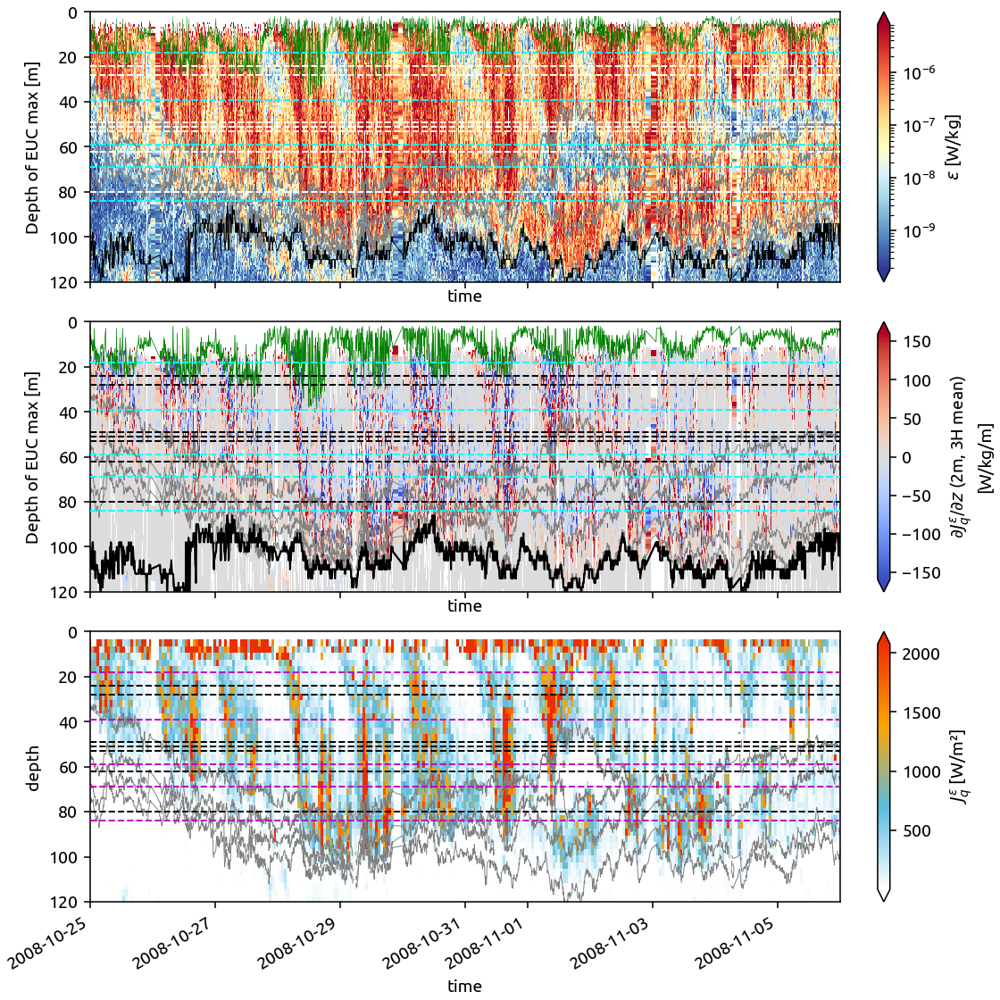

In [ ]:
%matplotlib widget

f, ax = plt.subplots(3, 1, sharex=True, sharey=True, constrained_layout=True)

equix.eps.cf.plot(
    x="time",
    cmap=mpl.cm.RdYlBu_r,
    norm=mpl.colors.LogNorm(),
    robust=True,
    ax=ax[0],
)
equix.theta.cf.plot.contour(
    levels=[21, 22, 23, 24], colors="gray", linewidths=0.5, x="time", ax=ax[0]
)
# equix.theta.cf.plot.contour(
#    levels=bins, colors="k", linewidths=0.25, x="time", ax=ax[0]
# )
equix.mld.plot(color="g", ax=ax[0], lw=0.25)
equix.eucmax.plot(color="k", ax=ax[0], lw=0.5)
dcpy.plots.liney(iop.depth.data, zorder=10, color="w", ax=ax[0])
dcpy.plots.liney(tao.depth.data, zorder=10, color="cyan", ax=ax[0])

smooth_dJdz = (
    -1
    * equix.dJdz
    # .coarsen(depth=2, boundary="trim")
    # .mean()
    # .resample(time="3H")
    # .mean()
)
smooth_dJdz.attrs["long_name"] += " (2m, 3H mean)"
smooth_dJdz.cf.plot(
    x="time",
    cmap=mpl.cm.coolwarm,
    robust=True,
    ax=ax[1],
)
equix.theta.cf.plot.contour(
    levels=[21, 22, 23, 24], colors="gray", linewidths=0.5, x="time", ax=ax[1]
)
equix.mld.plot(color="g", ax=ax[1], lw=0.25)
equix.eucmax.plot(color="k", ax=ax[1], lw=1)
dcpy.plots.liney(iop.depth.data, zorder=10, color="k", ax=ax[1])
dcpy.plots.liney(tao.depth.data, zorder=10, color="cyan", ax=ax[1])

(-1 * equix.Jq).coarsen(depth=3, boundary="trim").mean().resample(
    time="H"
).mean().cf.plot(
    x="time",
    cmap=dcpy.plots.white_blue_orange_red,
    robust=True,
    ax=ax[2],
)
equix.theta.cf.plot.contour(
    levels=[21, 22, 23, 24], colors="gray", linewidths=0.5, x="time", ax=ax[2]
)
equix.mld.plot(color="g", ax=ax[1], lw=0.25)
equix.eucmax.plot(color="k", ax=ax[1], lw=1)
dcpy.plots.liney(iop.depth.data, zorder=10, color="k", ax=ax[2])
dcpy.plots.liney(tao.depth.data, zorder=10, color="m", ax=ax[2])


plt.ylim([120, 0])
plt.xlim(["2008-10-25", "2008-11-06"])
f.set_size_inches((8, 8))

## Chameleon dJ/dz (depth space)

Temperature contours work shows that at short-ish time scales(< 12h) depth space averaging should be OK.

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
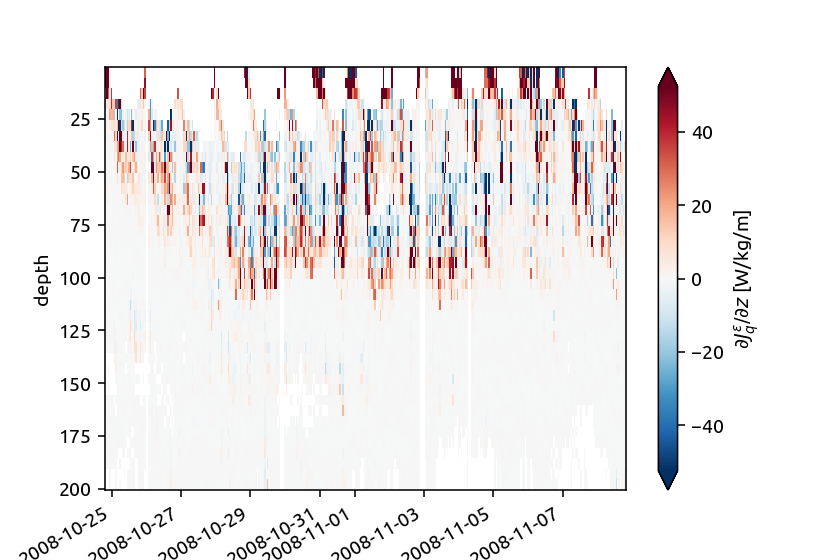

In [ ]:
%matplotlib widget
plt.rcParams["figure.dpi"] = 140
avg = equix.resample(time="H").mean().coarsen(depth=5).mean()
avg["dTdz"] = avg.theta.differentiate("depth")
avg["dTdz"] = avg.dTdz.where(np.abs(avg.dTdz) > 5e-3)
avg["Jq"] = 1025 * 4000 * avg.chi / 2 / avg.dTdz
avg["Jq"].attrs = equix.Jq.attrs
avg["dJdz"] = avg.Jq.differentiate("depth")
avg["dJdz"].attrs = equix.dJdz.attrs
avg.dJdz.cf.plot(robust=True)

In [ ]:
j = avg.Jq.resample(time="D").mean()
j = j.where(np.abs(j) < 1e4).drop_vars("time")

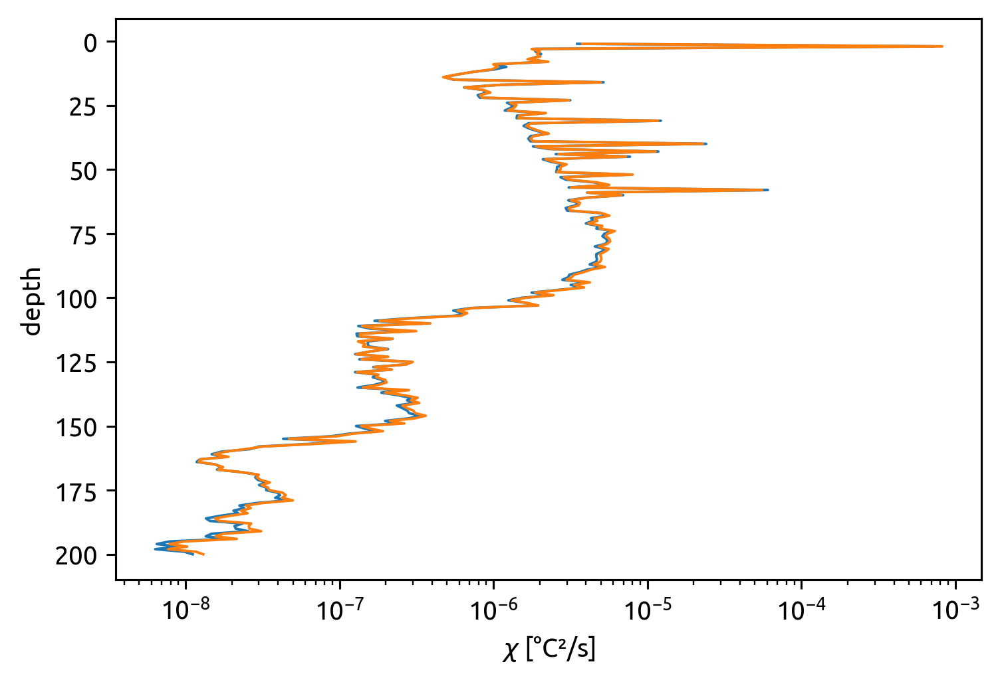

In [ ]:
equix_mean.chi.mean("time").plot(y="depth", xscale="log", yincrease=False)
equix.chi.mean("time").plot(y="depth", xscale="log")

In [ ]:
equix_mean = equix.resample(time="D").mean().drop_vars("time")
tao_mean = tao.sel(time=slice(equix.time[0], equix.time[-1])).resample(time="D").mean().drop_vars("time")
iop_mean = iop.sel(time=slice(equix.time[0], equix.time[-1])).resample(time="D").mean().drop_vars("time")

In [ ]:
da = ds[var].pipe(rescaler[var])
da.name = var
da.hvplot.line(y="depth", by="time"

:NdOverlay   [time]
   :Curve   [chi]   (depth)

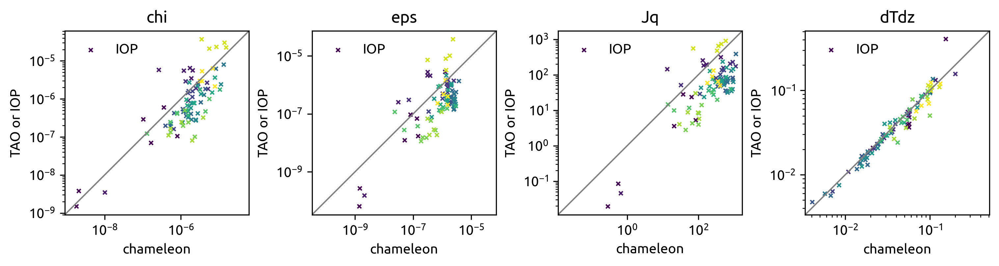

In [ ]:
%matplotlib inline
plt.rcParams["figure.dpi"] = 150

f, axx = plt.subplots(1, 4, constrained_layout=True)

for ax, var in zip(axx, ["chi", "eps", "Jq", "dTdz"]):
    for ds, marker, label in zip([iop_mean, tao_mean], ["x", "^"], ["IOP", "TAO"]):
        if label == "TAO":
            continue
        ax.scatter(
            np.abs(equix_mean[var]).sel(
                depth=ds.depth.isel(depth=slice(1, None)), method="nearest"
            ),
            np.abs(ds[var].isel(depth=slice(1, None))),
            s=8,
            c=np.repeat(ds.time.data, ds.sizes["depth"] - 1),
            marker=marker,
            label=label,
        )

    ax.legend()

    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_title(var)
    ax.set_xlabel("chameleon")
    ax.set_ylabel("TAO or IOP")

    dcpy.plots.line45(ax)


f.set_size_inches((10, 4))

# [axxx.set_xscale("log") for axxx in axx[:2]]
# [axxx.set_yscale("log") for axxx in axx[:2]]

In [ ]:
equix_mean = equix.resample(time="D").mean().drop_vars("time")
(equix_mean.chi.isel(depth=slice(20, None))).mean("time").cf.plot(xscale="log")
(equix_mean.eps).mean("time").cf.plot(xscale="log")

plt.gca().set_prop_cycle(None)
(equix.chi.isel(depth=slice(20, None))).mean("time").cf.plot(xscale="log")
(equix.eps.isel(depth=slice(20, None))).mean("time").cf.plot(xscale="log")

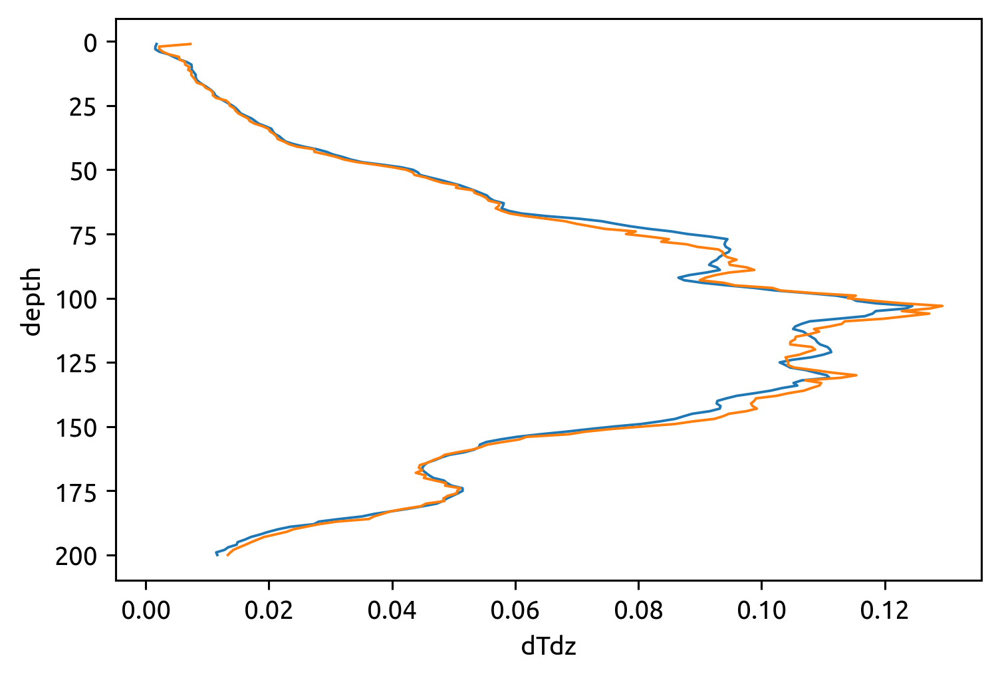

In [ ]:
equix_mean = equix.resample(time="D").mean().drop_vars("time")
equix_mean["dTdz"] = equix_mean.theta.differentiate("depth")
(np.abs(equix_mean.dTdz)**1).mean("time").cf.plot(xscale="linear")
#(0.2 * equix_mean.eps.isel(depth=slice(20, None))/equix_mean.N2).mean("time").cf.plot(xscale="log")

#plt.gca().set_prop_cycle(None)
(np.abs(equix.dTdz)**1).mean("time").cf.plot(xscale="linear")
#(0.2 * equix.eps.isel(depth=slice(20, None))/equix.N2).mean("time").cf.plot(xscale="log")

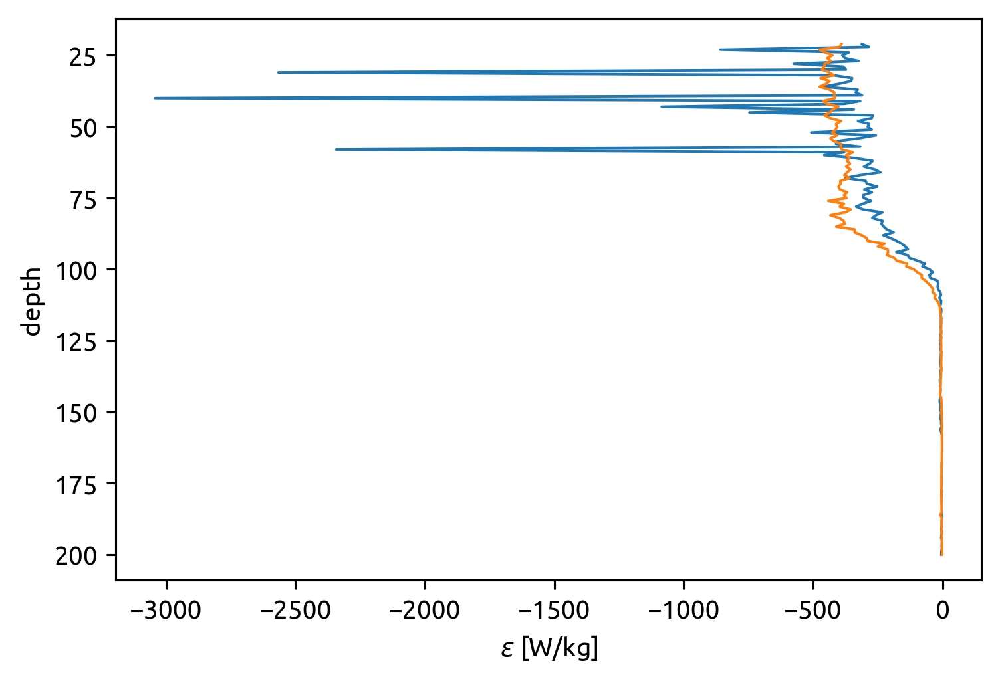

In [ ]:
(
    1025
    * 4000
    * 2 * equix_mean.chi.isel(depth=slice(20, None))
    /2
    / equix_mean.dTdz.where(np.abs(equix_mean.dTdz) > 1e-2)
).mean("time").cf.plot()
(
    1025
    * 4000
    * 0.2
    * equix_mean.eps.isel(depth=slice(20, None))
    / equix_mean.N2
    * equix_mean.dTdz
).mean("time").cf.plot()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
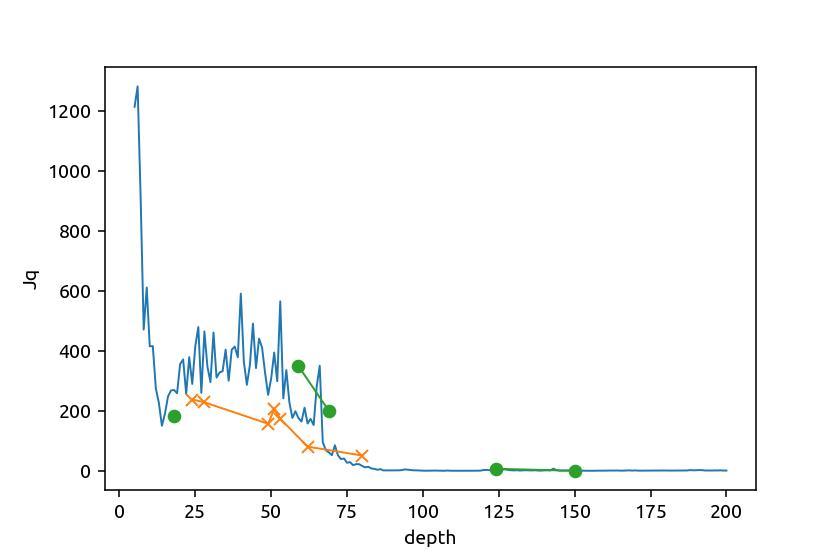

In [ ]:
plt.figure()
itime = 2
var = "Jq"
yscale = "linear"
equix_mean.sel(time=itime)[var].plot(yscale=yscale)
iop_mean.sel(time=itime)[var].plot(yscale=yscale, marker='x')
tao_mean.sel(time=itime)[var].plot(yscale=yscale, marker='o')

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
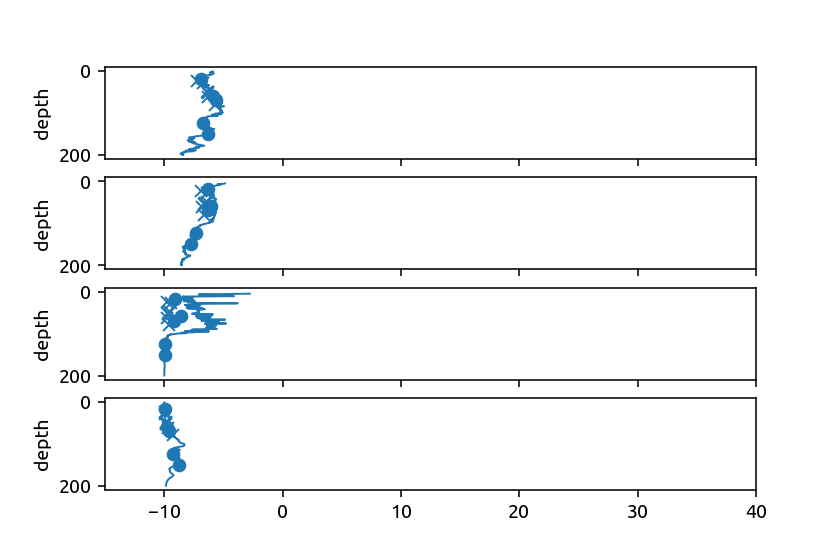

In [ ]:
%matplotlib widget

rescaler = {
    "chi": lambda x: np.log10(x) + x.time * 3,
    "eps": lambda x: np.log10(x) + x.time * 3,
    "Jq": lambda x: np.abs(x) / 150 + x.time * 3 - 10,
    "dTdz": lambda x: np.abs(x)*1e1 + x.time * 3 - 10,
}


f, axx = plt.subplots(4, 1, sharex=True, sharey=True)
names = ["chi", "eps", "Jq", "dTdz"]
ax = dict(zip(names, axx))
for var, aa in ax.items():
    for ds, kwargs in zip(
        [equix_mean, iop_mean, tao_mean],
        ({}, {"ls": "none", "marker": "x"}, {"ls": "none", "marker": "o"}),
    ):
        ds = ds.isel(time=[4])
        aa.set_prop_cycle(None)
        ds[var].pipe(rescaler[var]).cf.plot.line(
            hue="time", add_legend=False, xlim = (-15, 40), ax=aa, **kwargs
        )

# rescale(equix_mean.chi).cf.plot.line(hue="time", add_legend=False)
# ax.set_prop_cycle(None)
# rescale(iop_mean.chi).cf.plot.line(hue="time", marker="x", ls="none", add_legend=False)
# ax.set_prop_cycle(None)
# rescale(tao_mean.chi).cf.plot.line(hue="time", marker="o", ls="none", add_legend=False)

## Chameleon $w_{ci}$ estimate

Following Winters & D'Asaro (1996) §7. 

Take a group of profiles (e.g. 3 hours or a day, with approx. 6 profiles per hour), and choose temperature bin edges $θ_{bin} = θ_f$ ("theta at faces")


1. Calculate dT/dz: Identify pressure of each $θ_{f}$, find mean $Δp$ between each pair of bins in this group of profiles (mean distance between isotherms), then $⟨T⟩_z = Δθ_{f}/Δp$ at $θ_c$ ("theta centers")
1. Calculate heat flux $J_q = ρ c_p ⟨χ⟩/2/⟨T⟩_z$ at $θ_f$, where $⟨χ⟩$ is 1m χ averaged in temperature bins. 
1. Calculate $w_{ci} = 1/(ρc_p) ΔJ_q/Δθ_c$


TODO:
1. Check mld estimate
2. Ignore bin averages when number of observations is "small"

#### Choosing bins

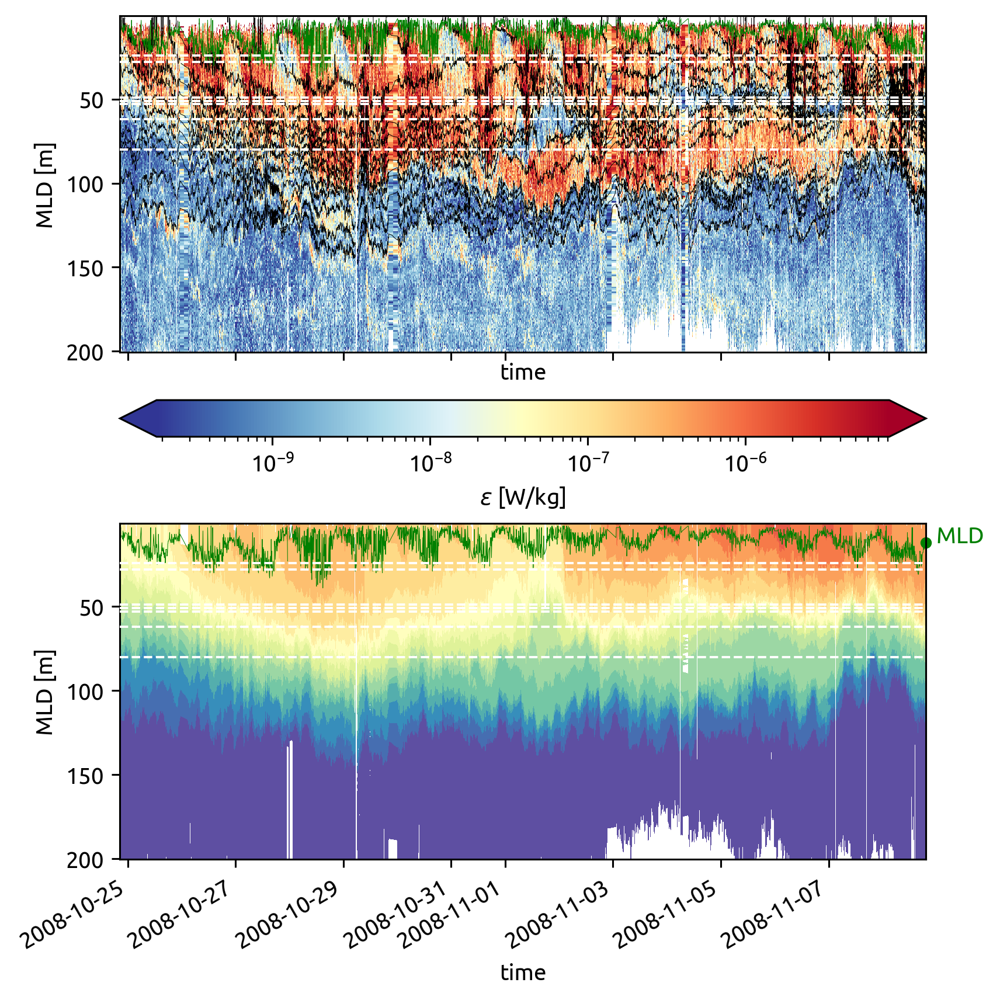

In [ ]:
bins = np.hstack(
    [np.arange(18, 23, 1), np.arange(23, 24, 0.5), np.arange(24, 27, 0.25)]
)

f, ax = plt.subplots(2, 1, sharex=True, sharey=True, constrained_layout=True)

equix.eps.cf.plot(
    x="time",
    cmap=mpl.cm.RdYlBu_r,
    norm=mpl.colors.LogNorm(),
    robust=True,
    ax=ax[0],
    cbar_kwargs={"orientation": "horizontal"},
)
equix.theta.cf.plot.contour(
    levels=bins, colors="k", linewidths=0.25, x="time", ax=ax[0]
)
equix.mld.plot(color="g", ax=ax[0], lw=0.25)
dcpy.plots.liney(iop.depth.data, zorder=10, color="w", ax=ax[0])

equix.theta.cf.plot.contourf(
    x="time",
    cmap=mpl.cm.Spectral_r,
    vmin=bins[0],
    vmax=bins[-1],
    levels=bins,
    ax=ax[1],
    add_colorbar=False,
)
dcpy.plots.liney(iop.depth.data, zorder=10, color="w", ax=ax[1])
hdl = equix.mld.plot(color="g", ax=ax[1], lw=0.25)
dcpy.plots.annotate_end(hdl[0], "MLD")

f.set_size_inches((6, 6))

### Example: 1 Day average

First panel shows mean θ (simple time average) in blue and the reconstructed T profile in orange. Not sure if I should be worried about the difference.

Second panel shows $J_q$ (blue) and $∂J/∂z$ in red (signed so that positive means heating).

Third panel is wci due to shear

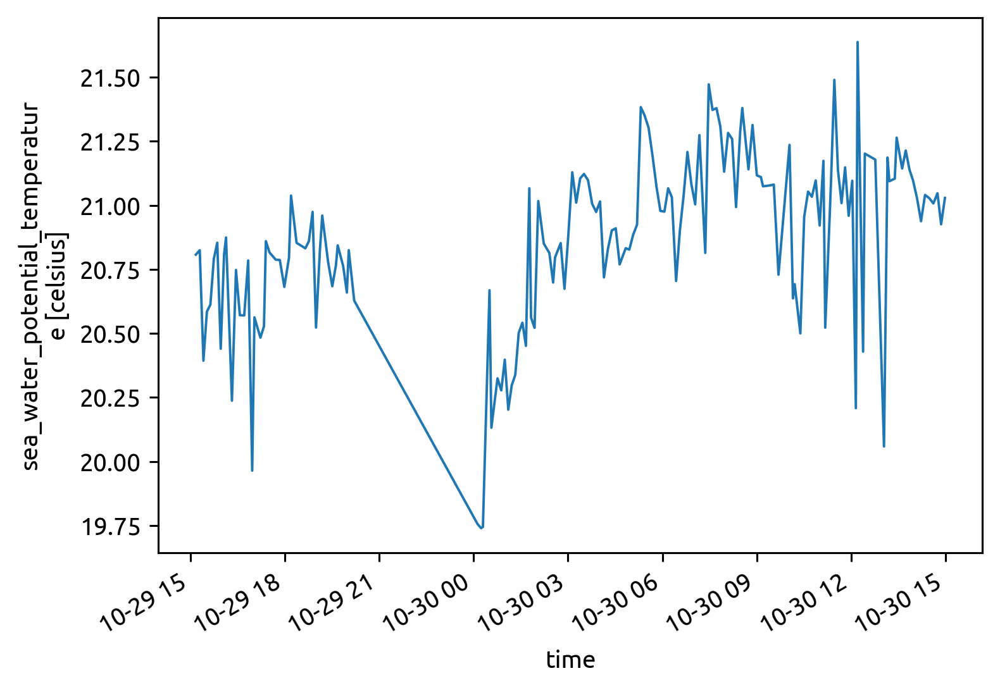

In [ ]:
profiles.theta.interp(depth=profiles.eucmax).plot()

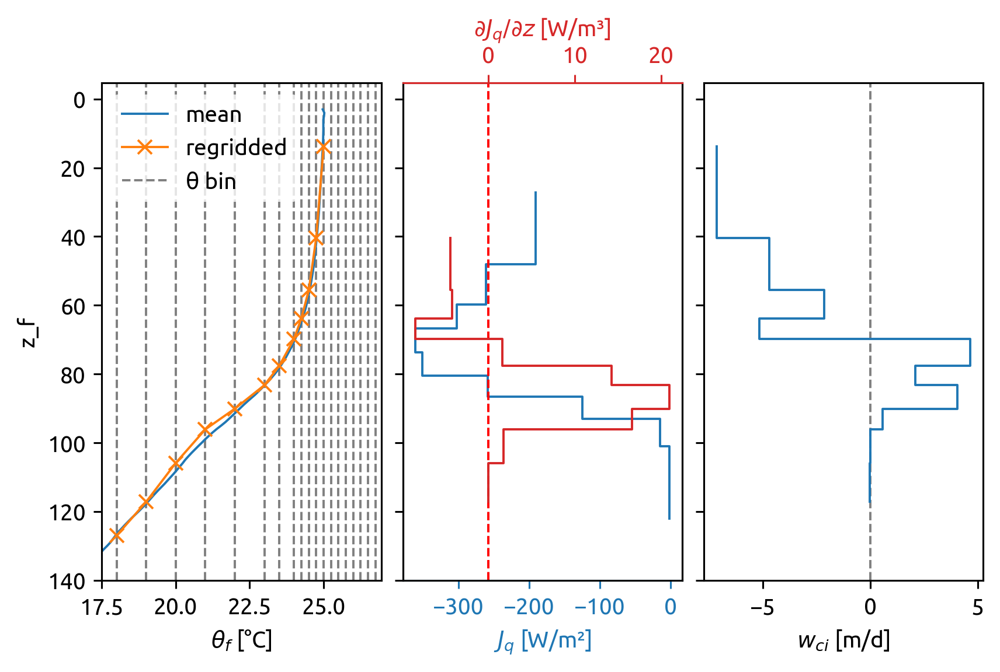

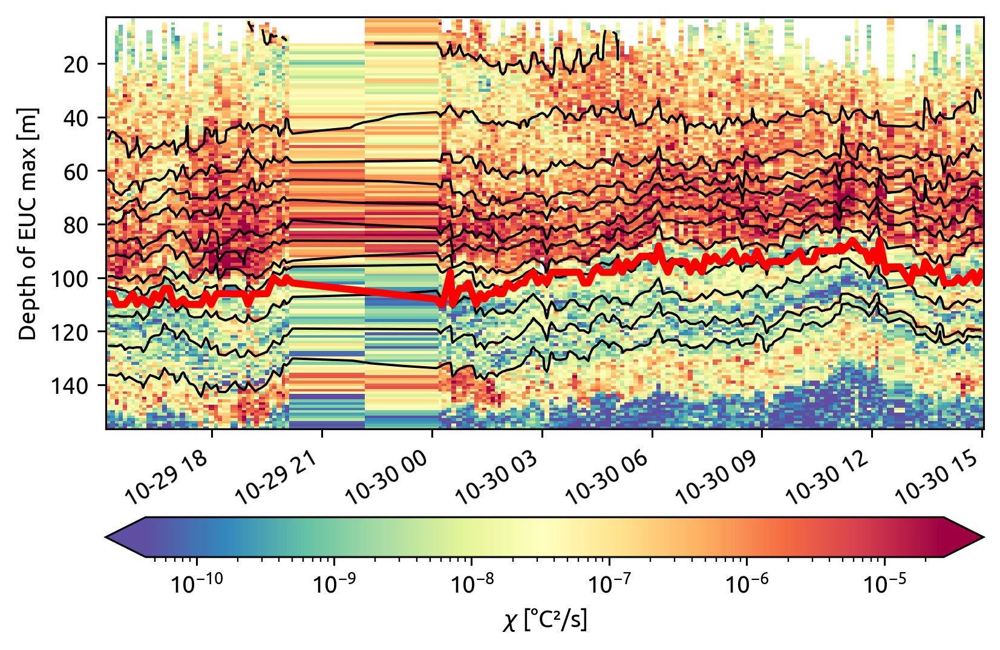

In [ ]:
profiles = equix.sel(
    time=slice("2008-10-29 15:00", "2008-10-30 15:00"), depth=slice(156)
)
eucmax = profiles.eucmax
profiles = profiles.where(profiles.depth > profiles.mld)
profiles["eucmax"] = eucmax
result = pump.tspace.regrid_chameleon_(profiles, bins=bins, debug=True, trim_mld=False)

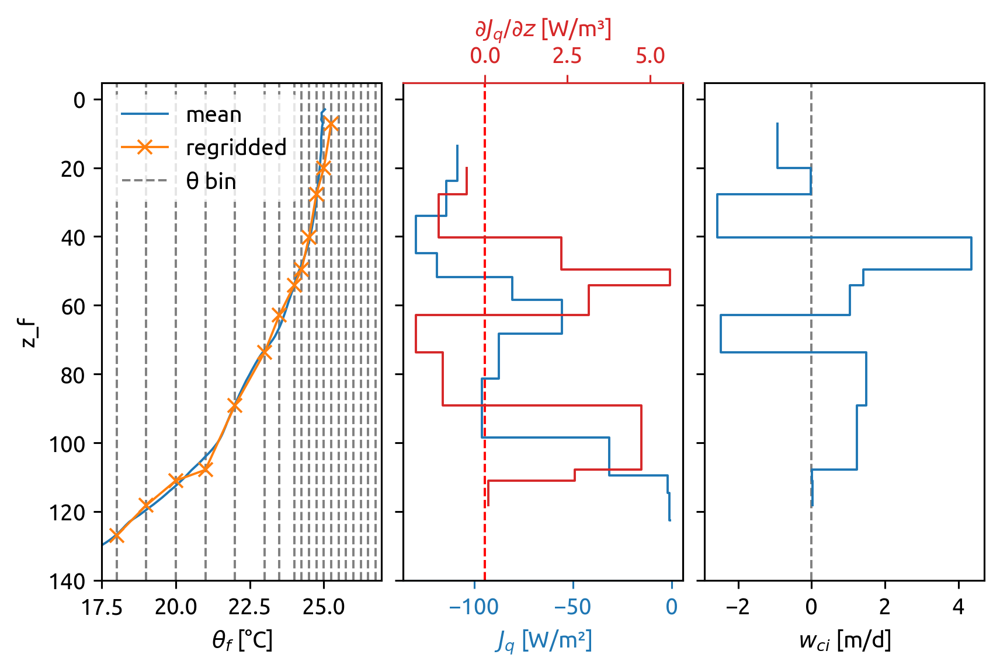

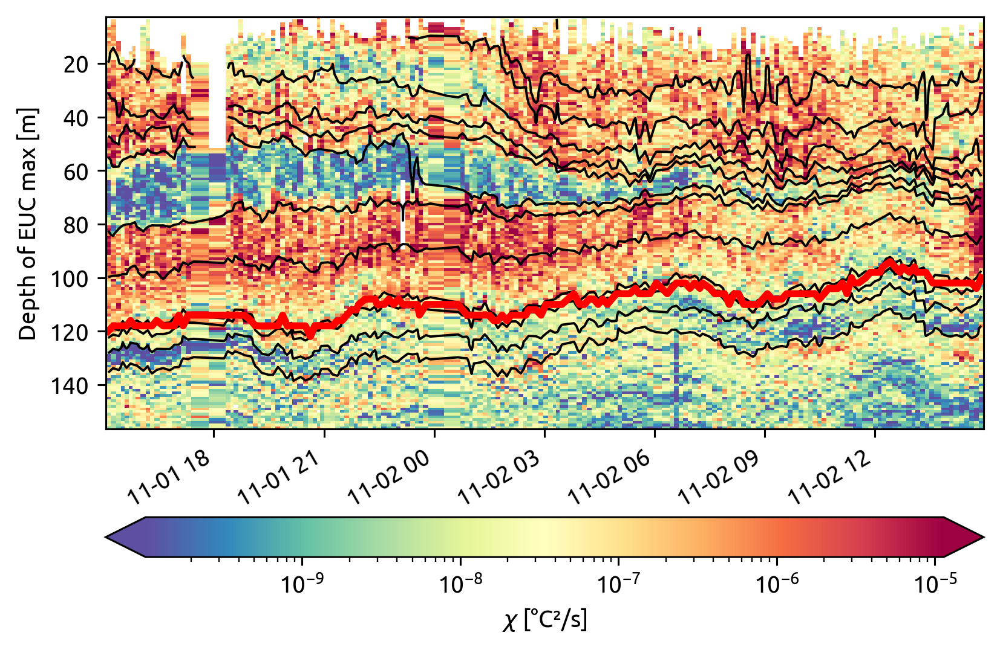

In [ ]:
profiles = equix.sel(
    time=slice("2008-11-01 15:00", "2008-11-02 15:00"), depth=slice(156)
)
eucmax = profiles.eucmax
profiles = profiles.where(profiles.depth > profiles.mld)
profiles["eucmax"] = eucmax
result = pump.tspace.regrid_chameleon_(profiles, bins=bins, debug=True, trim_mld=False)

The following figure is from before I switched to interpolating to find depth of isothermal surfaces, i.e. closer to what is proposed in Winters & D'Asaro (1996). Note that I seem to be losing heat during regridding (panel 1)

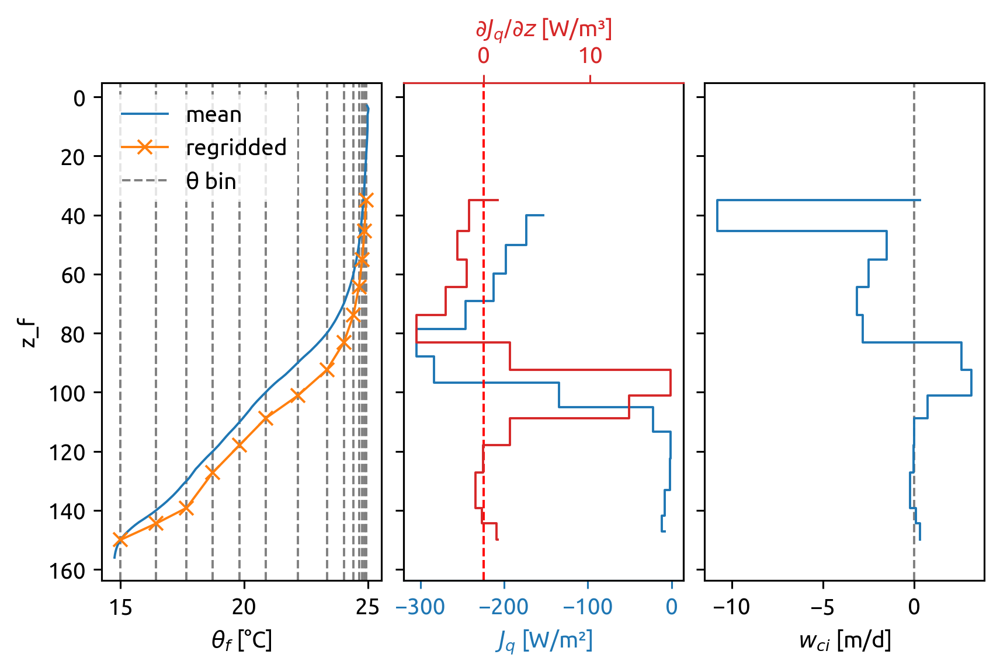

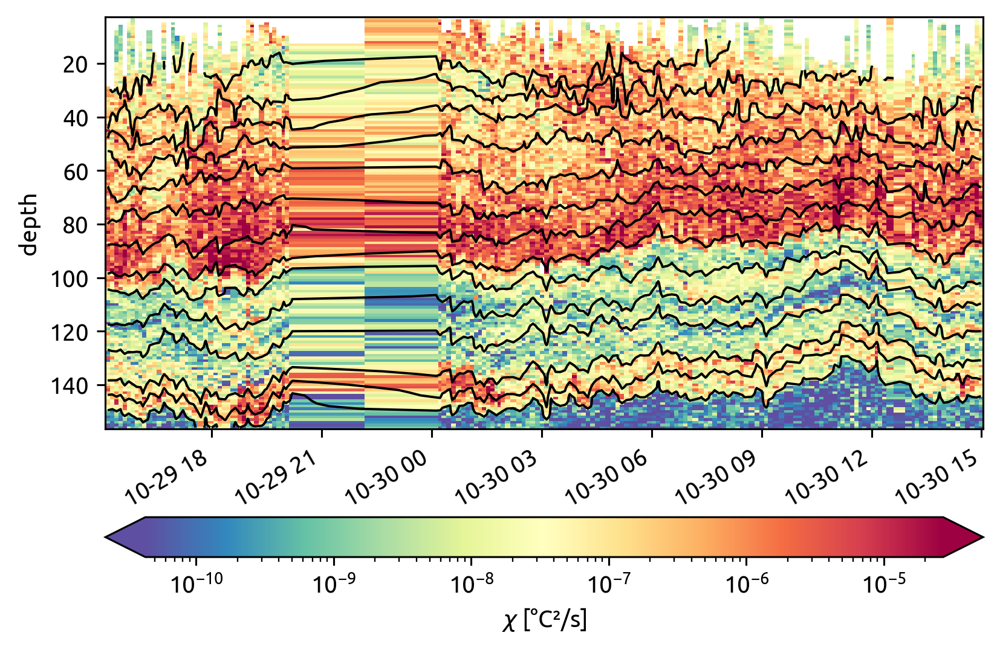

In [ ]:
profiles = equix.sel(
    time=slice("2008-10-29 15:00", "2008-10-30 15:00"), depth=slice(156)
)
profiles = profiles.where(profiles.depth > profiles.mld)
result = pump.tspace.regrid_chameleon_(profiles, debug=True, trim_mld=False)

### All data: 3 hour average

Here I use 3 hour averages for all the data. Exlude mld+5m to account for some uncertainty in finding MLD. I think it's too noisy, could be improved.

In [ ]:
equixT = pump.tspace.regrid_chameleon(
    equix.sel(depth=slice(156)).where(equix.depth > equix.mld + 5),
    time_freq="3H",
    bins=bins,
    trim_mld=False,
)

This summary plot shows ε for the full record and wci.

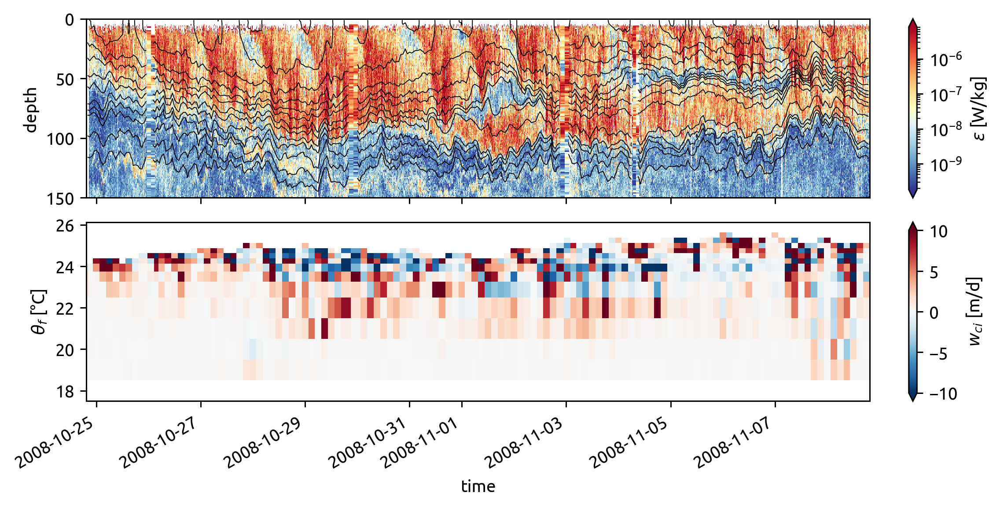

In [ ]:
f, ax = plt.subplots(2, 1, sharex=True, squeeze=False, constrained_layout=True)
equix.eps.cf.plot(
    x="time", cmap=mpl.cm.RdYlBu_r, norm=mpl.colors.LogNorm(), robust=True, ax=ax[0, 0]
)
# equix.dJdz.cf.plot(
#    x="time", cmap=mpl.cm.RdBu, vmin=-10, vmax=10, ax=ax[0, 0]
# )
equix.theta.resample(time="H").mean().cf.plot.contour(
    levels=equixT.theta_f,
    colors="k",
    linewidths=0.5,
    x="time",
    ax=ax[0, 0],
    ylim=(150, 0),
)
equixT.wci.sel(theta_f=slice(None, 26)).plot(x="time", vmin=-10, ax=ax[1, 0])

dcpy.plots.clean_axes(ax)
f.set_size_inches((8, 4))

### All data: daily average

I'm using a daily average starting at midnight.

In [ ]:
equixT = pump.tspace.regrid_chameleon(
    equix.sel(depth=slice(156)).where(equix.depth > equix.mld + 5),
    time_freq="1D",
    bins=bins,
    trim_mld=False,
)

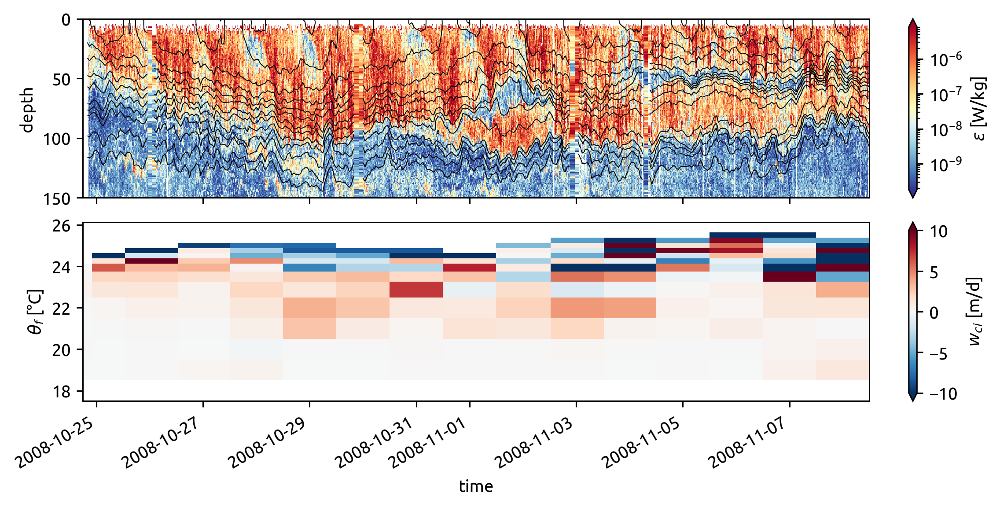

In [ ]:
f, ax = plt.subplots(2, 1, sharex=True, squeeze=False, constrained_layout=True)
equix.eps.cf.plot(
    x="time", cmap=mpl.cm.RdYlBu_r, norm=mpl.colors.LogNorm(), robust=True, ax=ax[0, 0]
)
# equix.dJdz.cf.plot(
#    x="time", cmap=mpl.cm.RdBu, vmin=-10, vmax=10, ax=ax[0, 0]
# )
equix.theta.resample(time="H").mean().cf.plot.contour(
    levels=equixT.theta_f,
    colors="k",
    linewidths=0.5,
    x="time",
    ax=ax[0, 0],
    ylim=(150, 0),
)
equixT.wci.sel(theta_f=slice(None, 26)).plot(x="time", vmin=-10, ax=ax[1, 0])

dcpy.plots.clean_axes(ax)
f.set_size_inches((8, 4))

### All data: 5-day average

Maybe this is comparable to POP2?

In [ ]:
equixT = pump.tspace.regrid_chameleon(
    equix.sel(depth=slice(156)).where(equix.depth > equix.mld + 5),
    time_freq="5D",
    bins=bins,
    trim_mld=False,
)

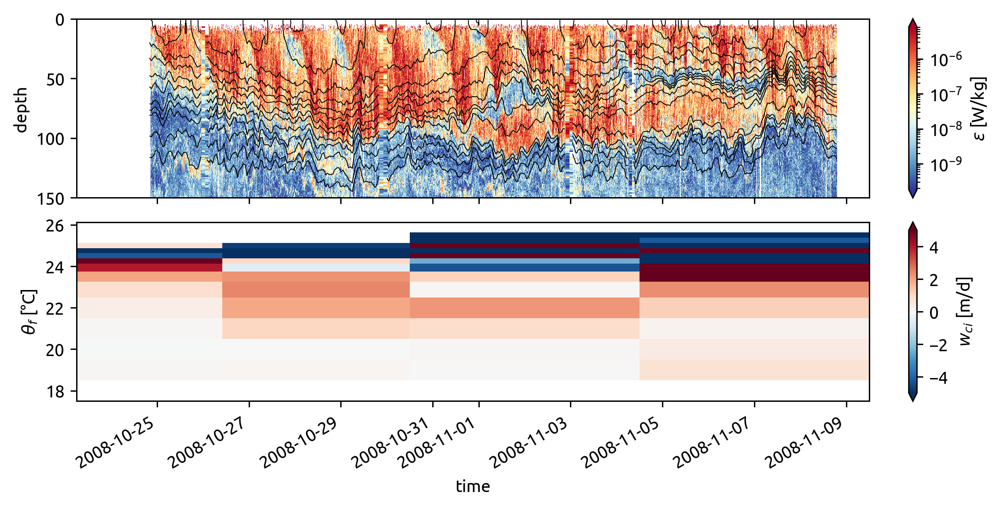

In [ ]:
f, ax = plt.subplots(2, 1, sharex=True, squeeze=False, constrained_layout=True)
equix.eps.cf.plot(
    x="time", cmap=mpl.cm.RdYlBu_r, norm=mpl.colors.LogNorm(), robust=True, ax=ax[0, 0]
)
# equix.dJdz.cf.plot(
#    x="time", cmap=mpl.cm.RdBu, vmin=-10, vmax=10, ax=ax[0, 0]
# )
equix.theta.resample(time="H").mean().cf.plot.contour(
    levels=equixT.theta_f,
    colors="k",
    linewidths=0.5,
    x="time",
    ax=ax[0, 0],
    ylim=(150, 0),
)
equixT.wci.sel(theta_f=slice(None, 26)).plot(x="time", vmin=-5, ax=ax[1, 0])

dcpy.plots.clean_axes(ax)
f.set_size_inches((8, 4))

### Conservative regridding

I think I'm losing heat when reconstructing the profile with mean ∂T/∂z! but this conservative thing gives a smaller spacing. I think there's a bug

In [ ]:
profiles = profiles.drop(["lon", "lat"]).cf.guess_coord_axis()

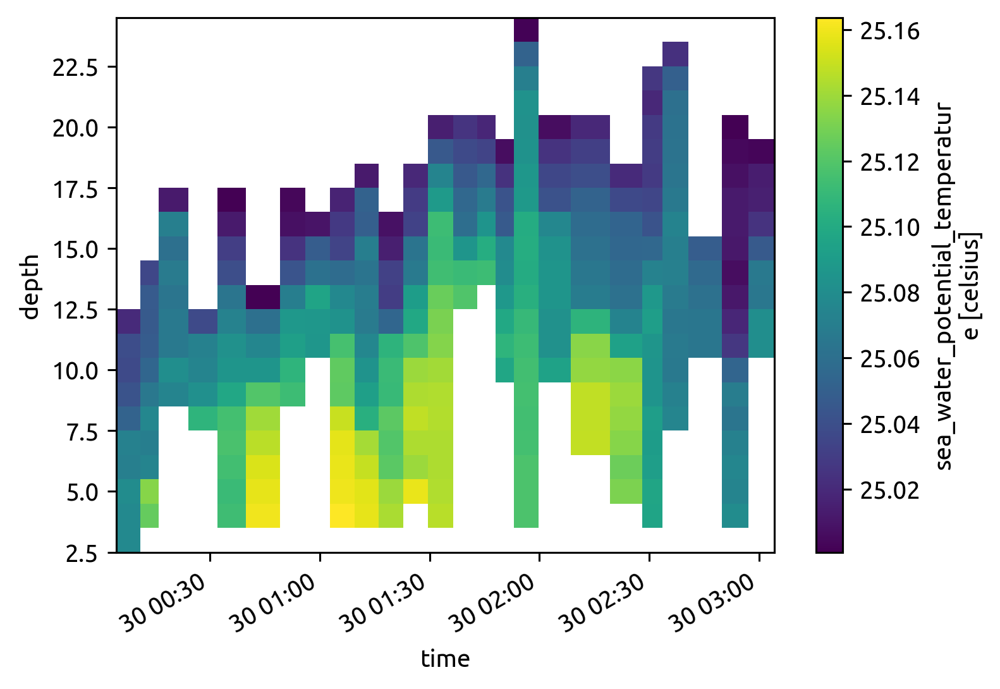

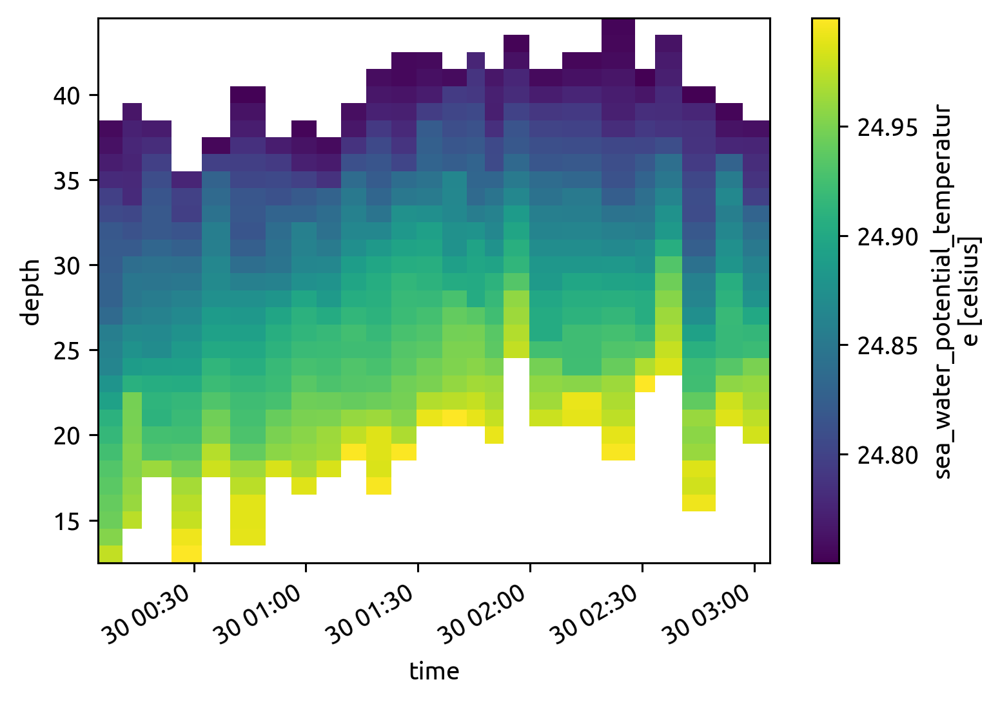

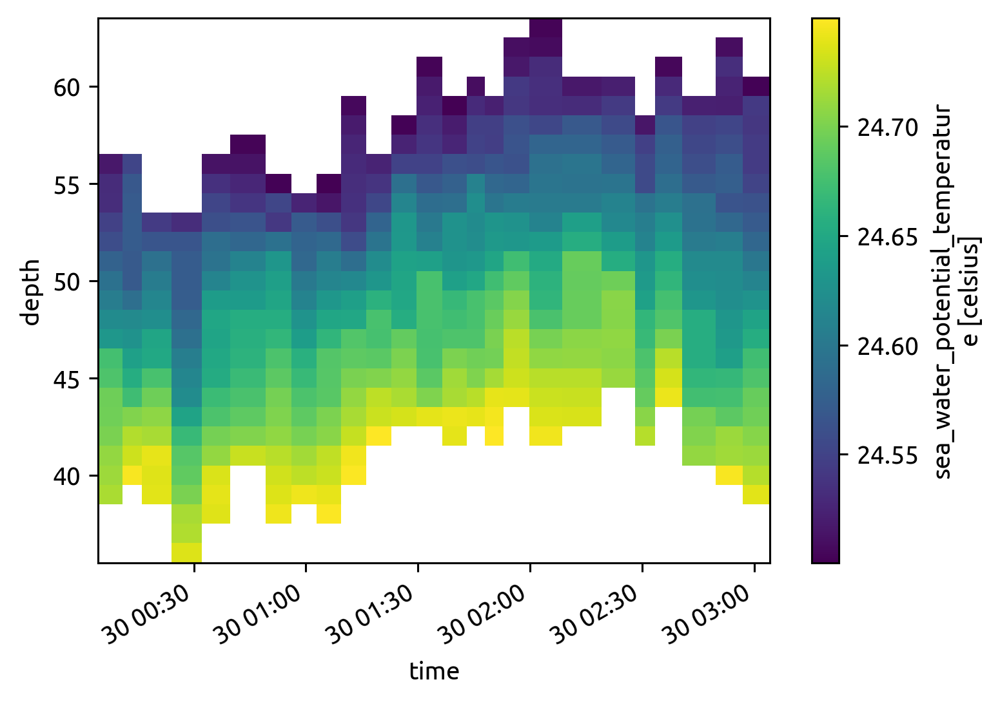

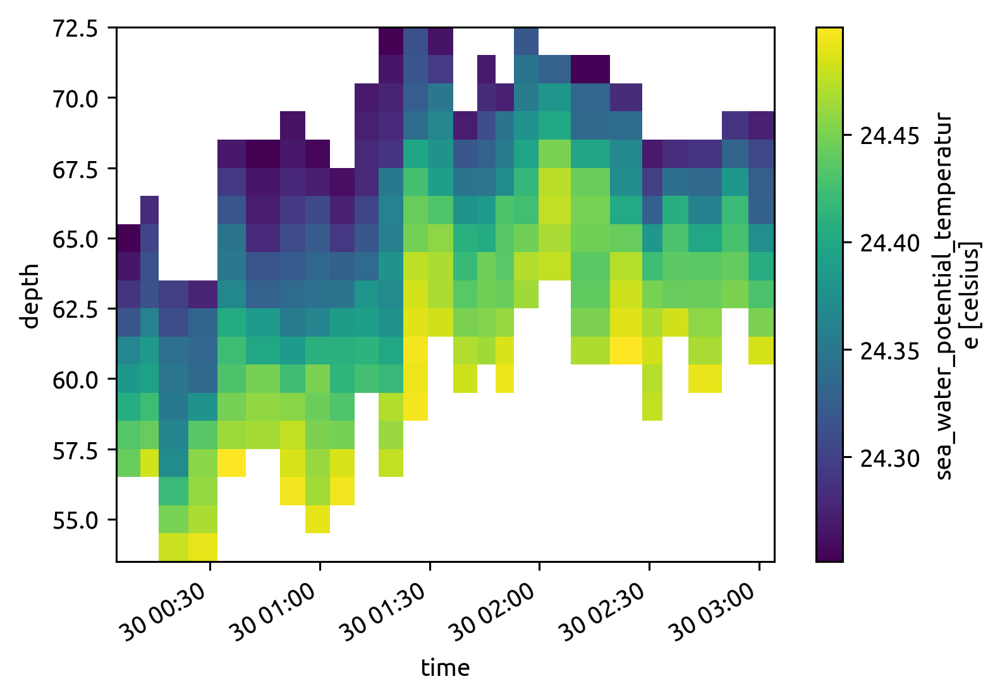

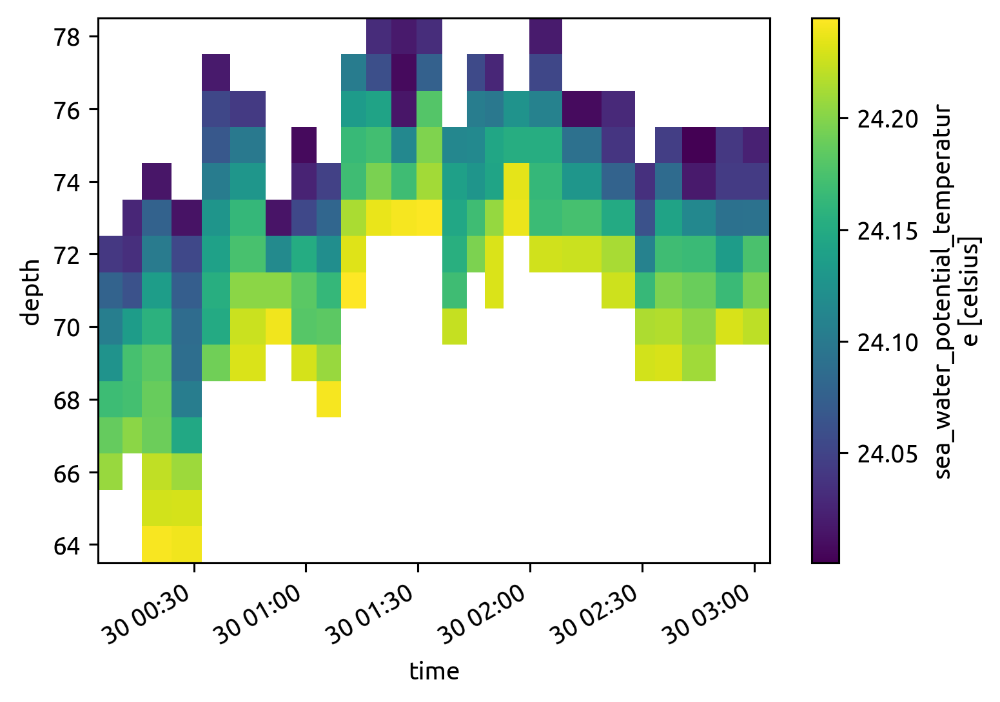

...

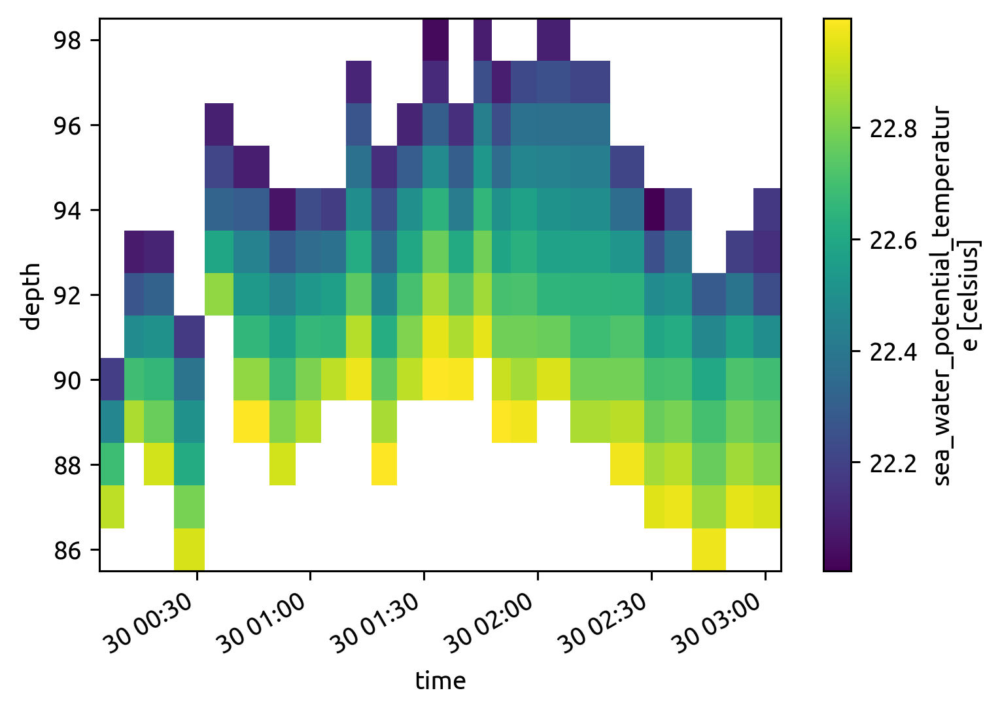

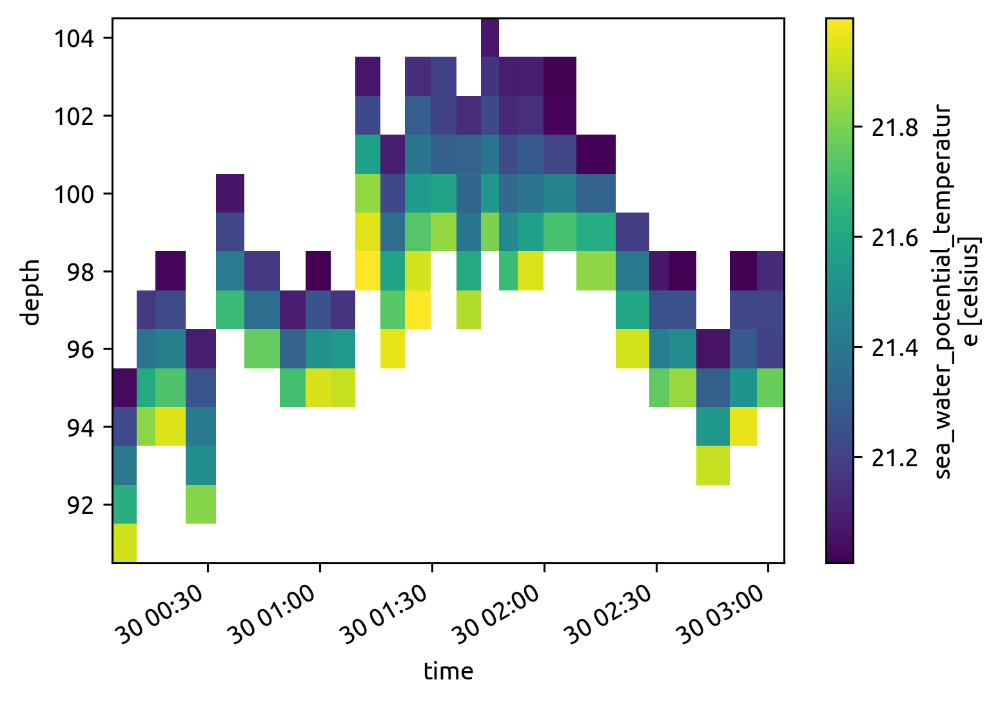

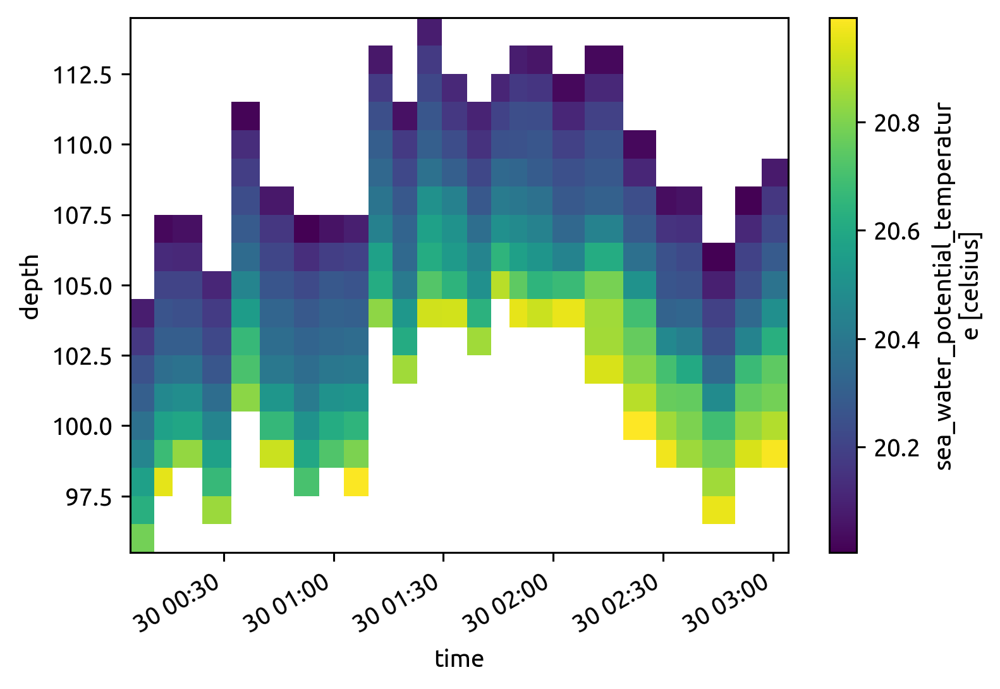

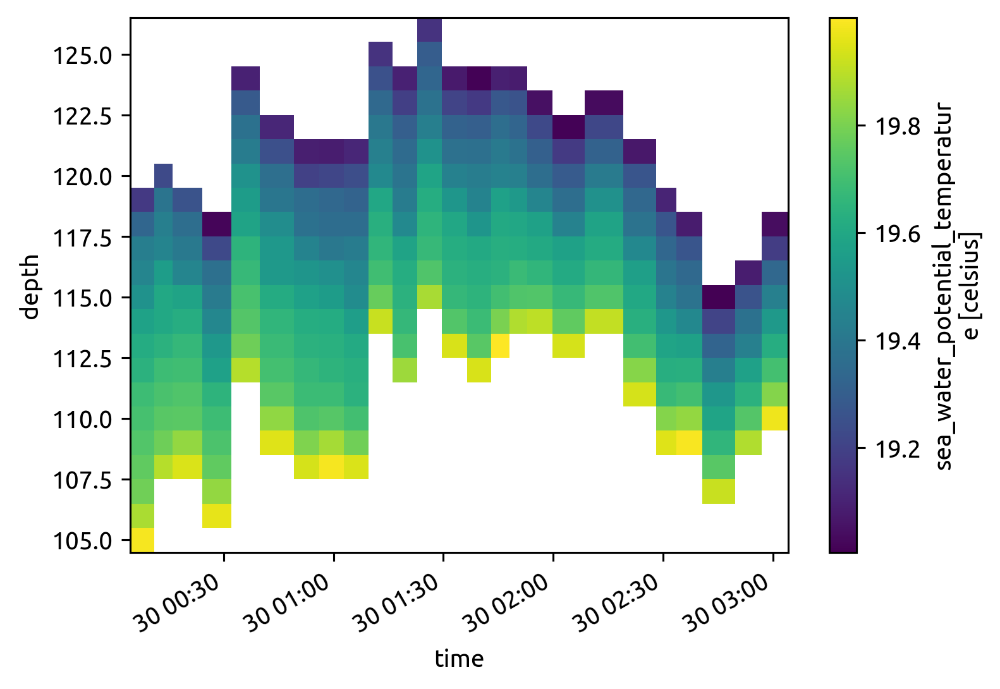

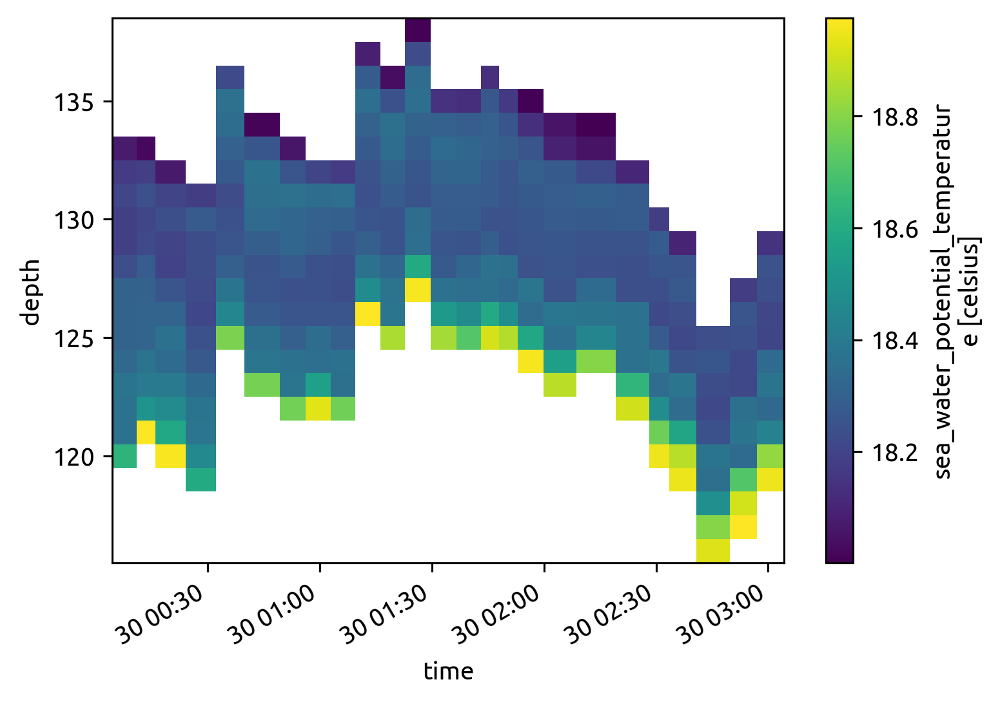

In [ ]:
grouped = (
    profiles[["theta", "pres"]]
    .sel(time=slice("2008-10-30 00:00", "2008-10-30 03:00"))
    .groupby_bins(
        "theta",
        bins=bins,
    )
)


dzs = []

for label, group in grouped:
    Tmean = (label.left + label.right) / 2
    temp = group.unstack().theta
    plt.figure()
    temp.plot()

    Δt = (temp.time[-1] - temp.time[0]).astype(int)

    dzs.append(
        xr.Dataset(
            {
                "mean": pump.tspace.get_avg_dz(group),
                "conservative": -1
                * (temp.fillna(0) - temp.min())
                .interpolate_na("depth")
                .integrate(["time", "depth"])
                / Δt
                / Tmean,
            }
        )
    )

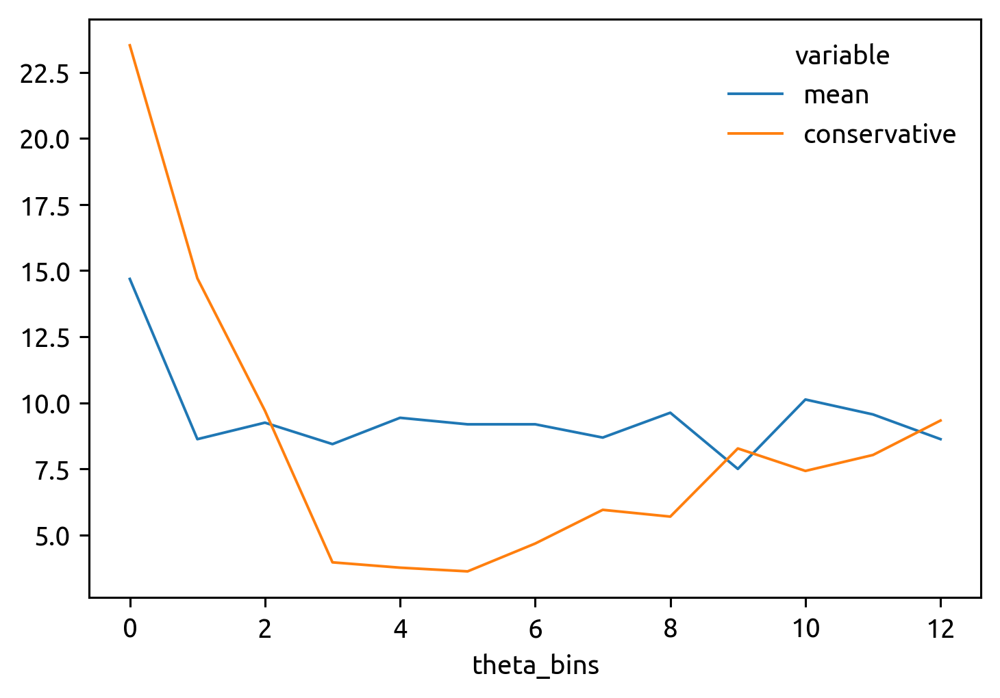

In [ ]:
xr.concat(dzs, dim="theta_bins").to_array().plot(hue="variable")

## Chameleon vs χpod: dJ/dz

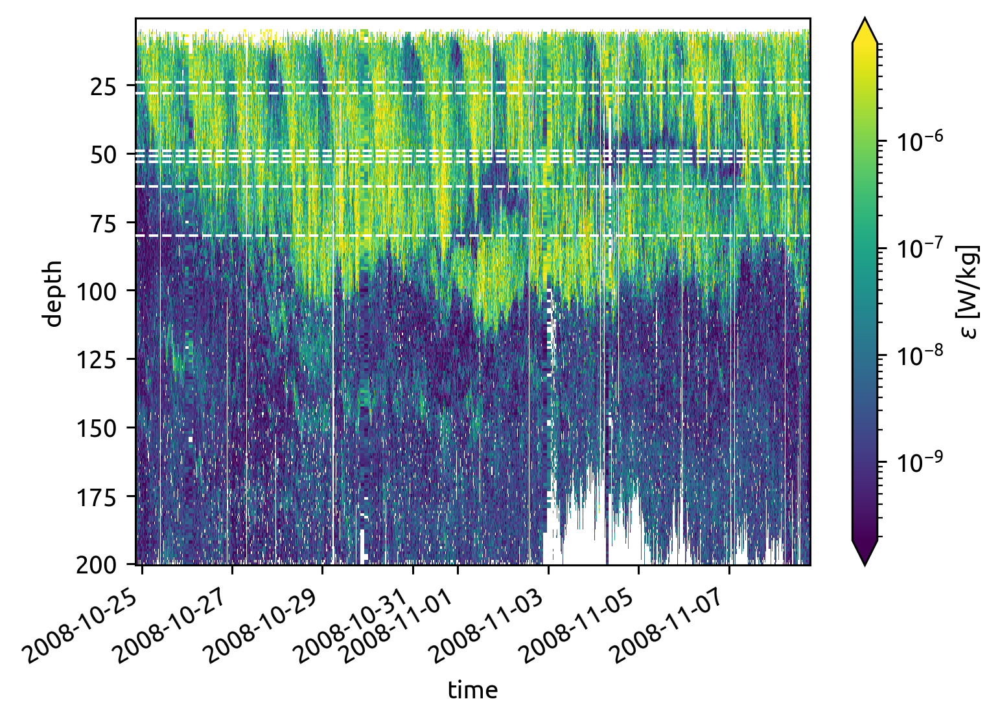

In [ ]:
equix.eps.cf.plot(x="time", robust=True, norm=mpl.colors.LogNorm())
dcpy.plots.liney(iop.depth.data, zorder=10, color="w")

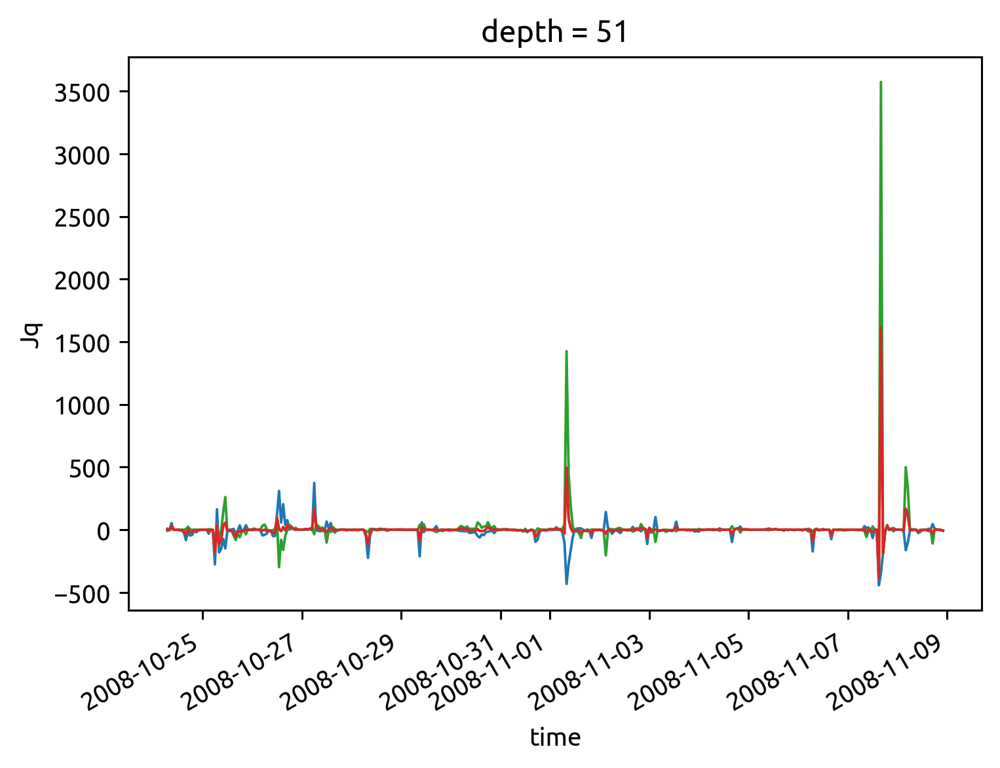

In [ ]:
iop.Jq.sel(depth=[49, 51]).differentiate("depth").isel(depth=1).plot()
iop.Jq.sel(depth=[49, 53]).differentiate("depth").isel(depth=1).plot()
iop.Jq.sel(depth=[51, 53]).differentiate("depth").isel(depth=1).plot()
iop.Jq.sel(depth=[49, 51, 53]).differentiate("depth").isel(depth=1).plot()

In [ ]:
import hvplot.xarray
import ipywidgets as ipw
import panel as pn


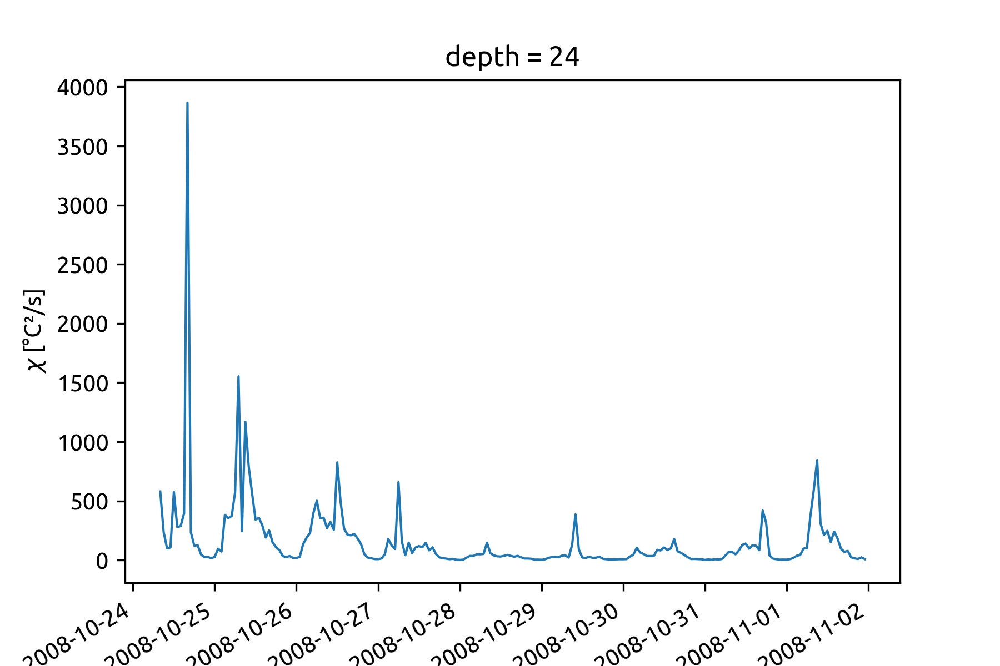

In [ ]:
iop.Jq.interactive.sel(depth=pn.widgets.DiscreteSlider).plot()

In [ ]:
import pump

T = pump.read_eq_tao_temp_hr()
tfloor = equix.time.dt.floor("D").data

taoT = (
    T.sel(longitude=-140, time=slice(tfloor[0], tfloor[-1]))
    .sel(depth=slice(-200, 0))
    .squeeze()
    .load()
    .dropna("depth", how="all")
)
del taoT.depth.attrs["positive"]
taoT["depth"] = taoT.depth * -1
# S = pump.read_eq_tao_salt_hr()

100%|███████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 88.18it/s]
/home/deepak/miniconda3/envs/dcpy/lib/python3.8/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


In [ ]:
%matplotlib widget
mpl.rcParams["figure.dpi"] = 140

plt.figure(constrained_layout=True)

bins = np.hstack([17, 20, 22.75, 24.25, 25])
# equix.chi.cf.plot(x="time", norm=mpl.colors.LogNorm(), robust=True)
(-1 * equix.dJdz).rolling(depth=7, center=True).mean().resample(
    time="4H"
).mean().cf.plot(x="time", robust=True, cmap=mpl.cm.RdBu_r)
# taoT.cf.plot(robust=True)
taoT.cf.plot.contour(yincrease=False, levels=bins, colors="darkgreen")
dcpy.plots.liney(tao.depth, zorder=10, lw=1.5, color="darkgray", label="T")
dcpy.plots.liney(
    iop.depth,
    zorder=10,
    lw=1.5,
    color="k",
    label="E",
)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [ ]:
plt.figure()
iop.theta.cf.plot()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [ ]:
plt.figure()
iop.Jq.sel(depth=[49, 51, 53]).differentiate("depth").isel(depth=1).resample(
    time="D"
).mean().plot()
equix.dJdz.rolling(depth=5, center=True).mean().resample(time="D").mean().sel(
    depth=51, method="nearest"
).plot()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

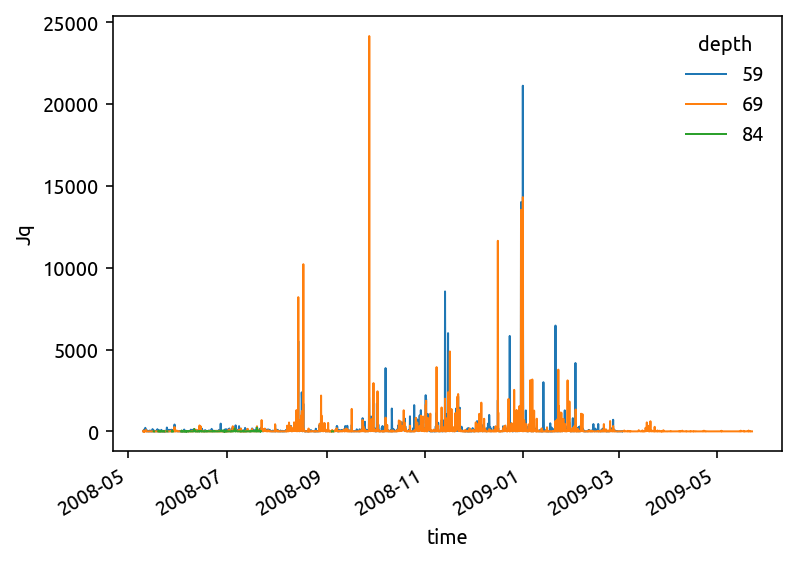

In [ ]:
%matplotlib inline

tao.Jq.resample(time="3H").mean().sel(depth=[59, 69, 84]).plot(hue="depth")

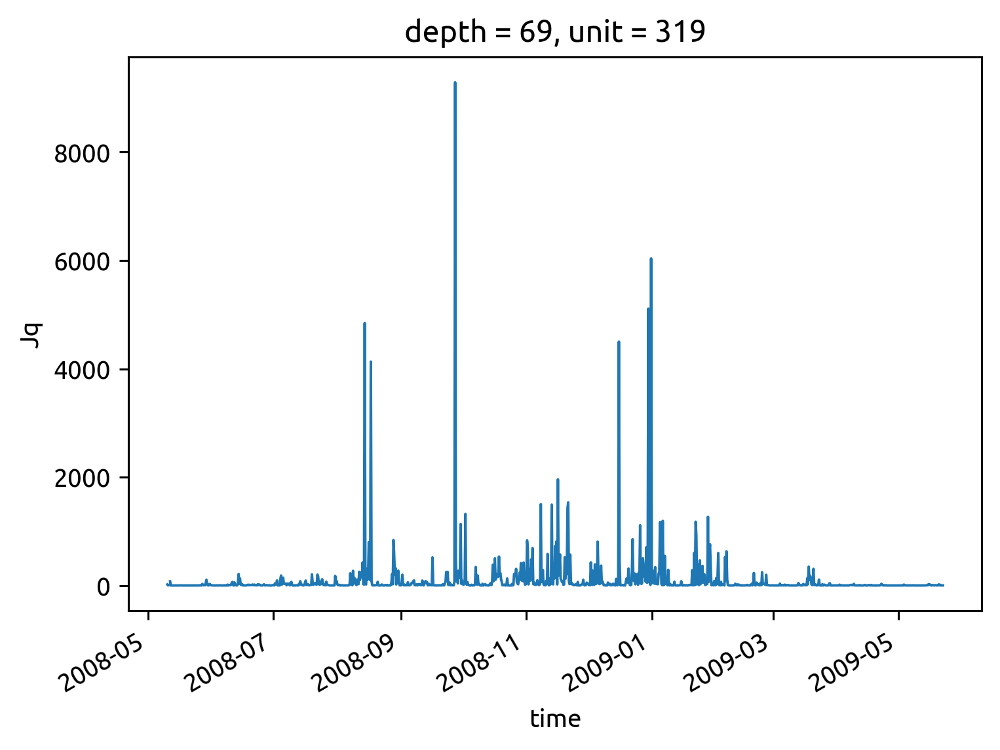

In [ ]:
%matplotlib inline
plt.rcParams["figure.dpi"] = 140
(tao.Jq.sel(depth=69).resample(time="8H").mean()).plot()

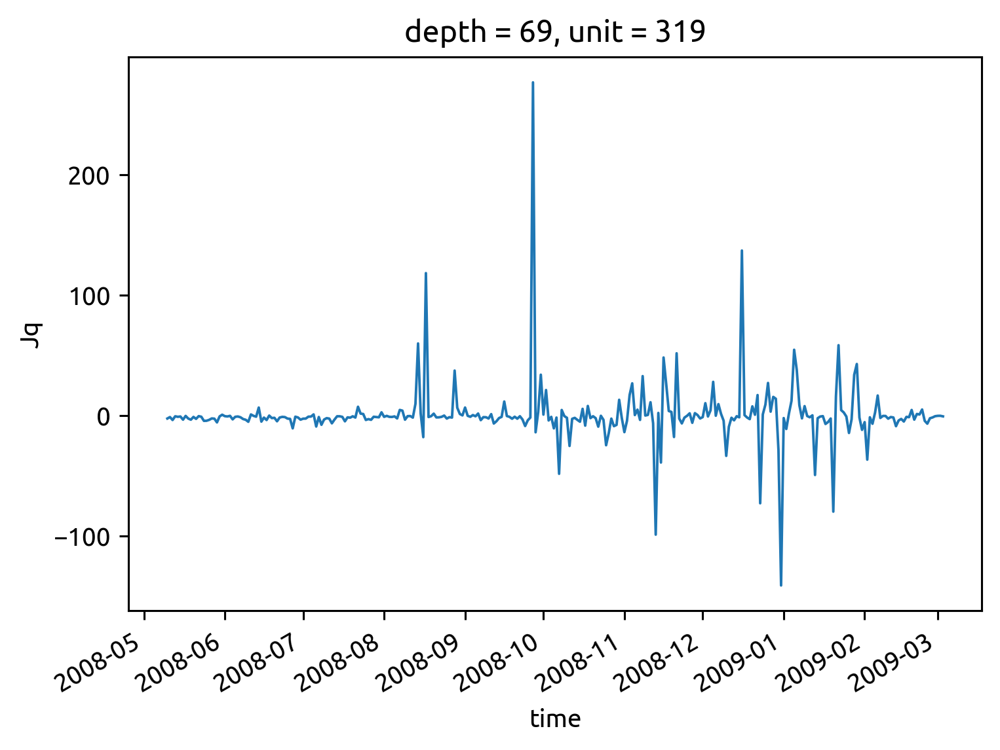

In [ ]:
Δ = tao.sel(depth=[59, 69]).diff("depth").resample(time="D").mean()

(Δ.Jq / 10).plot()